In [17]:
# This R environment comes with many helpful analytics packages installed
# It is defined by the kaggle/rstats Docker image: https://github.com/kaggle/docker-rstats
# For example, here's a helpful package to load

library(tidyverse) # metapackage of all tidyverse packages

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

list.files(path = "../input")

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

character(0)

# Tutorial de Modelos de Regresión Lineal Múltiple

En este tutorial conocerás cómo adaptar modelos lineales a series de tiempo que presentan componentes estructurales tales como tendencia, estacionalidad y ruido. Particulamente, aprenderás a generar las estructuras de dependencia que conforman los features o variables explicativas más importantes del modelo, ingresarlos a una función típica de regresión lineal y obtener resultados. Usaremos una base de datos que ayuda a ejemplificar el uso de las diferentes paqueterías y funciones contempladas en este tutorial. Esta base es la base de datos de Amtrak, famosa por ser usada en una competencia de kaggle [1](#0)

El contenido de este tutorial está organizado de la siguiente manera. En la primera parte, generaremos un modelo con la paquetería de tslm(), donde partiremos de la importación de paqueterías y datos necesarios; aquí, modelaremos paso a paso cada uno de los componentes de la serie. En la segunda parte del tutorial, emplearemos una función básica de regresión lineal, la lm() para modelar las estructuras de la serie. En la tercera parte, aplicaremos la paquetería de ModelTime para el modelamiento, el cual genera otra manera de análisis y predicción de la series. En cada uno de estas partes, generaremos el pronóstico a futuro.

**Contenido**
1. [Modelación con función tslm()](#1) 
    1. [Importación de librerías requeridas](#2)
    1. [Importación de datos](#3)
    1. [Indexado de fecha y visualización](#4)
    1. [Identificación de features](#5)
    1. [Partición de datos de entrenamiento y prueba](#6)
    1. [Especificación del modelo de tendencia](#7)
    1. [Especificación del modelo de tendencia polinómica](#8)
    1. [Especificaciónd el modelo con estacionalidad](#9)
    1. [Especificación del modelo con todos los componentes](#10)
    1. [Obtención de métricas de error](#11)
    1. [Generación del pronóstico hacia adelante](#12)
1. [Modelación con función lm()](#13)
    1. [Importación de datos](#14)
    1. [Partición de datos de entrenamiento y prueba](#15)
    1. [Especificación del modelo lineal con lm()](#16)
    1. [Predicción con datos de prueba](#17)
    1. [Obtención de métricas de error](#18)
    1. [Generación del pronóstico hacia adelante](#19)
1. [Modelación con TimeModel()](#20)
    1. [Partición de datos en entrenamiento y prueba](#21)
    1. [Especificaicón del modelo lineal](#22)
    1. [Adición del modelo de ajuste a Model Table](#23)
    1. [Calibración y obtención de métricas de error](#24)
    1. [Generación del pronóstico hacia adelante](#25)

<a id="1"></a> <br>
## 1. Modelación con función tslm()

Comenzaremos este tutorial empleando la función de tslm() a la serie. Como verás, iremos generando modelos que contemplan los diferentes componentes de las series, para termiar con uno que incluye todos los componentes: tendencia lineal, polinómica y estacionalidades.

<a id="2"></a> <br>
## A. Importación de librerías requeridas

La importación incluye paquetes para el modelado de los datos, el manejo de las series y la visualización.

In [18]:
library(forecast)
library(fpp3)
library(tidymodels)
library(modeltime)
library(tidyverse)
library(lubridate)
library(timetk)
library(tsfeatures)
library(TSstudio)
interactive <- TRUE
options(warn = - 1) 

<a id="3"></a> <br>
### B. Importación de datos
La importación de datos la debes realizar a manera que subas el archivo llamado "Amtrak_data.csv", disponible en Github y en la plataforma. Su importación dependerá de tu perfil, si es público o privado. Si es privado, deberás contar con espacio disponible.

In [19]:
#Importar el data.csv
df<-read.csv("./Amtrak_data.csv", sep=";", header=TRUE)
head(df)

,Month,Ridership,Season,t
,<chr>,<int>,<chr>,<int>
1,01/01/1991,1709,Jan,1
2,01/02/1991,1621,Feb,2
3,01/03/1991,1973,Mar,3
4,01/04/1991,1812,Apr,4
5,01/05/1991,1975,May,5
6,01/06/1991,1862,Jun,6


<a id="4"></a> <br>
### C. Indexado de fecha y visualización

Para facilitar las siguientes operaciones, tales de visualización y modelado, debes generar una columna con el formato de fecha, así como el formato particular tipo ts().

In [20]:
# Creamos columna de fecha, a partir de otra, que es la de Month.
df$Date<- as.Date(df$Month, format='%d/%m/%Y')
str(df)
head(df)

'data.frame':	159 obs. of  5 variables:
 $ Month    : chr  "01/01/1991" "01/02/1991" "01/03/1991" "01/04/1991" ...
 $ Ridership: int  1709 1621 1973 1812 1975 1862 1940 2013 1596 1725 ...
 $ Season   : chr  "Jan" "Feb" "Mar" "Apr" ...
 $ t        : int  1 2 3 4 5 6 7 8 9 10 ...
 $ Date     : Date, format: "1991-01-01" "1991-02-01" ...


,Month,Ridership,Season,t,Date
,<chr>,<int>,<chr>,<int>,<date>
1,01/01/1991,1709,Jan,1,1991-01-01
2,01/02/1991,1621,Feb,2,1991-02-01
3,01/03/1991,1973,Mar,3,1991-03-01
4,01/04/1991,1812,Apr,4,1991-04-01
5,01/05/1991,1975,May,5,1991-05-01
6,01/06/1991,1862,Jun,6,1991-06-01


In [21]:
# Creamos una visualización.
df%>%plot_time_series(Date, Ridership, .interactive = interactive)

HTML widgets cannot be represented in plain text (need html)

In [22]:
# Pasamos a formato tipo ts.
df.ts=ts(df$Ridership,  start = c(1991,1), end = c(2004, 3), freq = 12)
head(df.ts)

,Jan,Feb,Mar,Apr,May,Jun
1991,1709,1621,1973,1812,1975,1862


<a id="5"></a> <br>
### D. Identificación de features

Para la identificación de features o variables regresores a ingresar al modelo, podemos dar un vistazo a los features más relevantes de los datos, a través de la función tsfeatures(). Igualmente, podemos descomponer la serie para tener una visualización de la tendencia, estacionalidad y finalmente, podemos generar una visualización del comportamiento mensual de la variable de interés.

 

In [23]:
# Veamos los features.
tsfeatures(df.ts)

frequency,nperiods,seasonal_period,trend,spike,linearity,curvature,e_acf1,e_acf10,seasonal_strength,peak,trough,entropy,x_acf1,x_acf10,diff1_acf1,diff1_acf10,diff2_acf1,diff2_acf10,seas_acf1
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
12,1,12,0.8849994,5.061985e-07,5.296767,5.417397,0.2252234,0.2725558,0.9042972,8,2,0.5997911,0.5597374,1.102407,-0.2563941,0.9013333,-0.5021715,1.062631,0.7531213


Mediante la función tsfeatures(), podemos observar que la serie posee datos anuales con frecuencia mensual, es decir, frecuencia 12 cada 1 periodo, así como periodos estacionales igualmente mensuales. La linealidad es superior a uno, lo cual es relevante. El nivel de entropia o de dificutad en la predicción, dada la presencia de estructuras complejas en la serie, está por debajo de 1. Otros features relacionan características más específicas de correlaciones seriales lineales y cuadráticas, pero por el momento, podemos retomar estas comentadas para tener idea de la buena elección en la aplicabilidad de los modelos lineales.

Veamos ahora los componentes de la serie, la función "multiple seasonal time serie decomposition by loess" o "mstl" genera una descompoisción empleando un algoritmo STL (Seasonal Decomposition of Time Series by Loess, que funciona por suavizamientos), donde se permiten estacionalidades múltiples y de manera automaizada llega a la descomposición óptima.

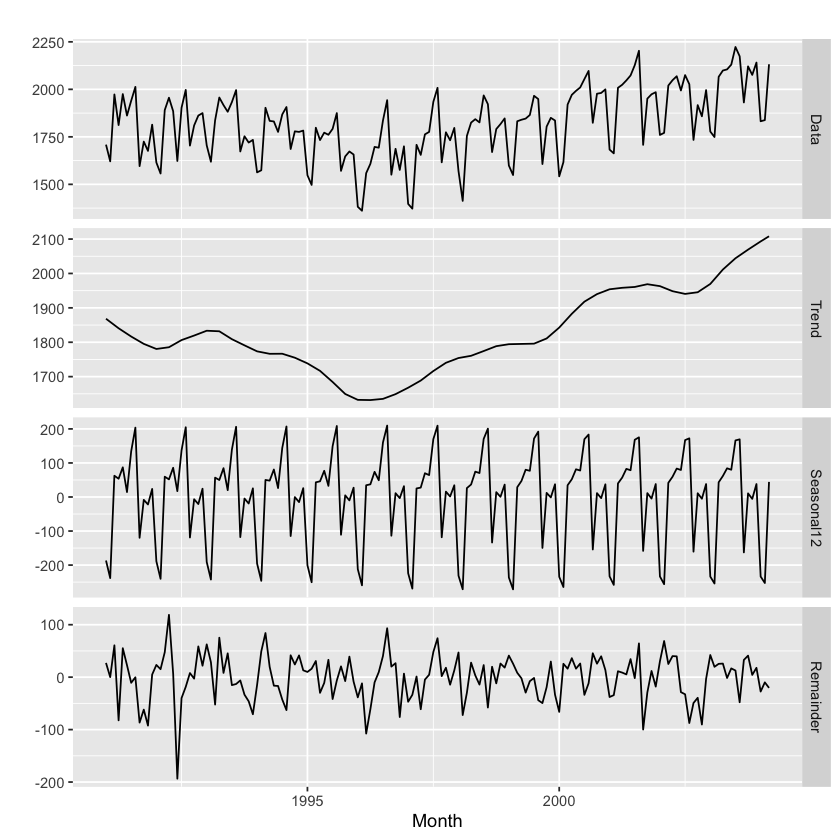

In [24]:
# Descomponenmos con la función mstl y visualizamos los componentes.
mstl(df.ts)%>%autoplot()+xlab("Month")

En la gráfica se observa que la tendencia que posee un comportamiento polinómico y su comportamiento mensual "Seasonal 12".

Otra técnica para visualizar los features relevantes, es mediante la visualización de los datos anuales con frecuencia mensual. Esta gráfica es útil ya que podemos darnos idea de qué meses o rezagos o features serán relevantes en el modelo lineal.

In [25]:
# Otra herramienta de visualización para el comonente de estacionalidad, es mediante la eliminación de la tendencia. Luego, imprimimos la de la estacionalidad.
detre= mstl(df.ts)
df_detrend <- df.ts - detre[,2]
ts_seasonal(df_detrend, type = "box")

HTML widgets cannot be represented in plain text (need html)

<a id="6"></a> <br>
### E. Partición de datos de entrenamiento y prueba
Partamos la serie en entrenamiento y validación

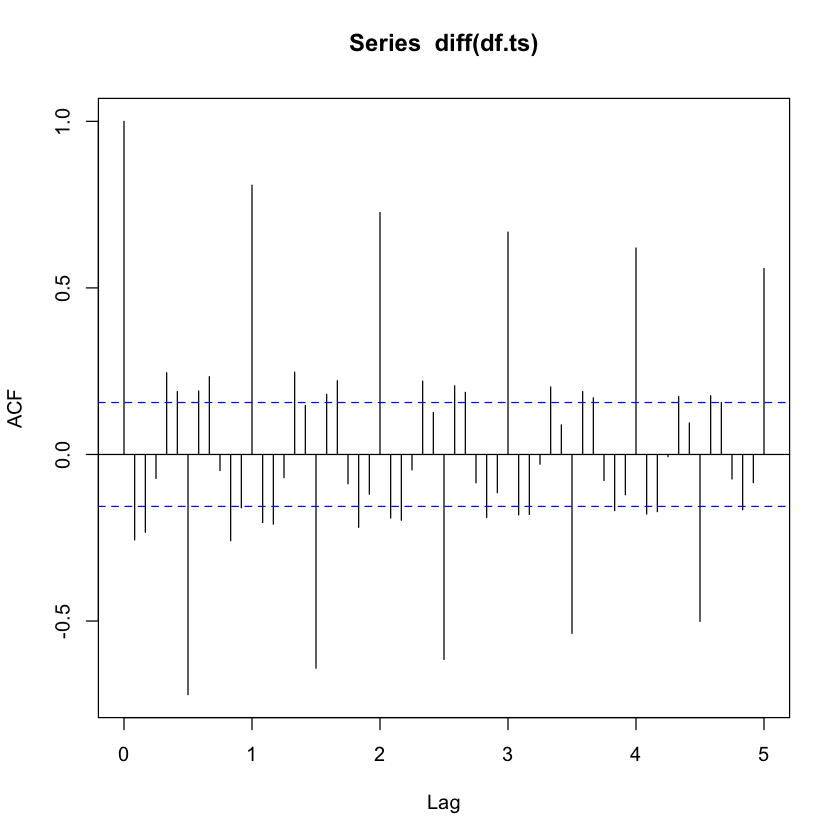

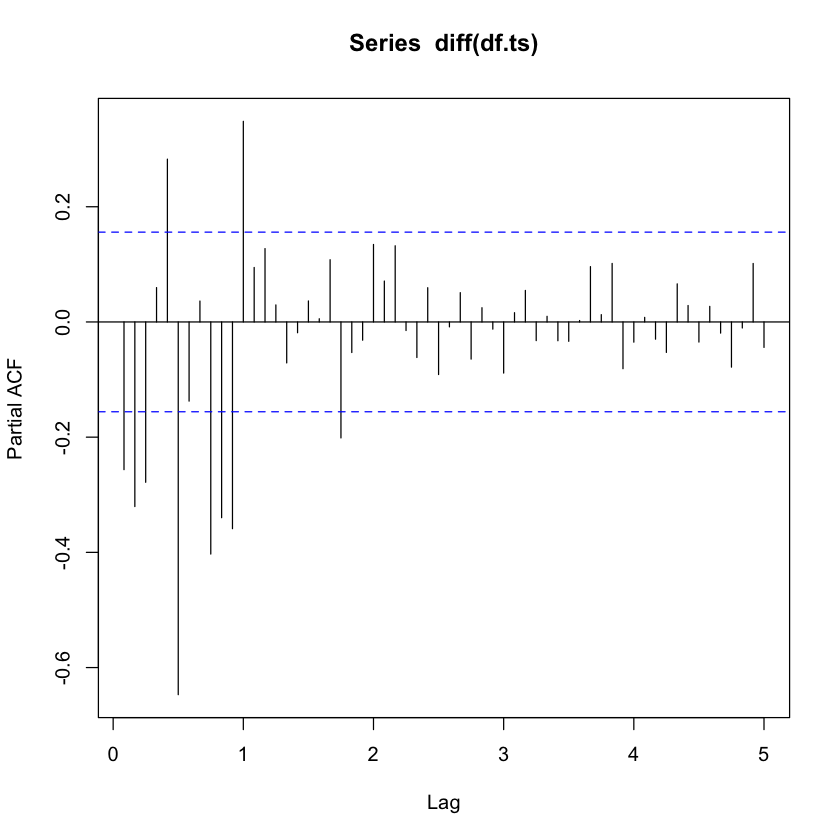

In [26]:
# También podemos usar los tradicionales ACF y PACF.
acf(diff(df.ts), 60)
pacf(diff(df.ts), 60)

Vemos un patrón estacionario semestral en ACF.

In [27]:
# Partimos la serie, podemos tomar en porcentaje, o mediante la definición de valores.
nValid <- 36
nTrain <- length(df.ts) - nValid
entren.ts <- window(df.ts, start = c(1991, 1), end = c(1991, nTrain))
valid.ts <- window(df.ts, start = c(1991, nTrain + 1), end = c(1991, nTrain + nValid))

<a id="7"></a> <br>
### F. Modelos con tendencia
Vamos a aplicar un modelo de regresión lineal simple mediante la función tslm(), estableciendo la variable y y el predictor como la variable de tiempo:

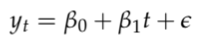

Donde Y_t es el valor de la respuesta en el tiempo t y e es el error estándar o ruido blanco del modelo de regresión. Así, modelaremos tres de los cuatro componentes de las series de tiempo: nivel (beta cero), tendencia (Beta 1), y ruido (e). La estacionalidad no la modelaremos ahorita, sino más adelante.

In [28]:
# Empleamos la función tslm(). Aquí, aplicamos la función de transformación de Box Cox automática mediante la función de lambda.
entren.lm = tslm(entren.ts~trend, lambda="auto")
summary(entren.lm)
#str(entrena.lm)
#train.lm.linear.trend <- tslm(train.ts ~ trend, lambda = 1)  #Si deseáramos aplicar una transformación logarítmica a la serie.


Call:
tslm(formula = entren.ts ~ trend, lambda = "auto")

Residuals:
    Min      1Q  Median      3Q     Max 
-656495 -209193   14044  225402  578376 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 1539743.7    50610.5  30.423   <2e-16 ***
trend           684.8      708.4   0.967    0.336    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 278900 on 121 degrees of freedom
Multiple R-squared:  0.007664,	Adjusted R-squared:  -0.0005371 
F-statistic: 0.9345 on 1 and 121 DF,  p-value: 0.3356


In [29]:
# En esta opción, eliminamos la función de transformación de datos con Box Cox. No es muy diferente.
entren.lm2 = tslm(entren.ts~trend)
summary(entren.lm2)


Call:
tslm(formula = entren.ts ~ trend)

Residuals:
    Min      1Q  Median      3Q     Max 
-411.18 -113.76   15.73  129.62  305.91 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 1750.4615    29.0676  60.220   <2e-16 ***
trend          0.3503     0.4068   0.861    0.391    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 160.2 on 121 degrees of freedom
Multiple R-squared:  0.006089,	Adjusted R-squared:  -0.002125 
F-statistic: 0.7413 on 1 and 121 DF,  p-value: 0.391


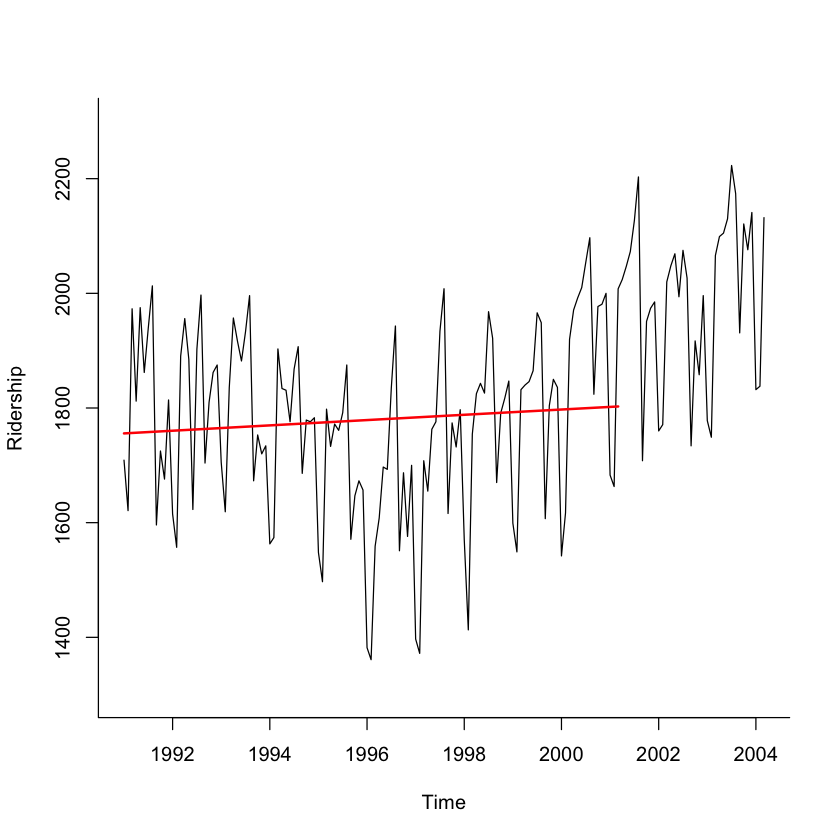

In [30]:
# Podemos graficar el resultado. Imprimimos primero la serie original y sobreponemos el ajuste.
plot(df.ts, xlab="Time", ylab="Ridership", ylim=c(1300,2300), bty="l", col="black")
lines(entren.lm$fitted, lwd=2, col="red")

In [35]:
# Actualizamos librerías:
library(tsibble)
library(fable)
library(tidyverse)
library(TSstudio)
library(MAPA)

Loading required package: smooth

Loading required package: greybox

Registered S3 method overwritten by 'greybox':
  method     from
  print.pcor lava

Package "greybox", v2.0.0 loaded.



Attaching package: ‘greybox’


The following object is masked from ‘package:yardstick’:

    accuracy


The following objects are masked from ‘package:fabletools’:

    MAE, MAPE, MASE, ME, MPE, MSE, RMSSE


The following object is masked from ‘package:tsibble’:

    measures


The following object is masked from ‘package:lubridate’:

    hm


The following object is masked from ‘package:tidyr’:

    spread


This is package "smooth", v4.0.1



Attaching package: ‘smooth’


The following object is masked from ‘package:yardstick’:

    accuracy


The following object is masked from ‘package:parsnip’:

    pls




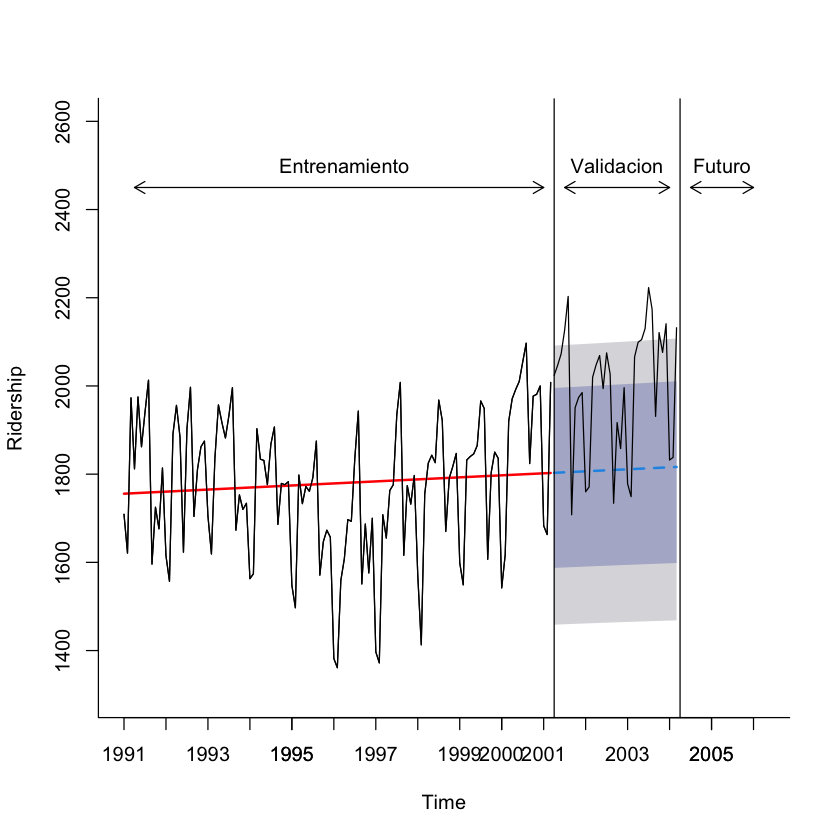

In [36]:
# Visualizamos los gráficos:
entren.lm.pred = forecast(entren.lm, h=nValid)
plot(entren.lm.pred, ylim=c(1300,2600), ylab="Ridership", xlab="Time", bty="l", xlim=c(1991,2006.25), main="", flty=2)
axis(1, at=seq(1991,2006,1), labels=format(seq(1991,2006,1)))
lines(entren.lm.pred$fitted, lwd=2,col="red")
lines(valid.ts)
lines(entren.ts)
lines(c(2004.25 - 3, 2004.25 - 3), c(0, 3500)) 
lines(c(2004.25, 2004.25), c(0, 3500))
text(1996.25, 2500, "Entrenamiento")
text(2002.75, 2500, "Validacion")
text(2005.25, 2500, "Futuro")
arrows(2004 - 3, 2450, 1991.25, 2450, code = 3, length = 0.1, lwd = 1,angle = 30)
arrows(2004.5 - 3, 2450, 2004, 2450, code = 3, length = 0.1, lwd = 1,angle = 30)
arrows(2004.5, 2450, 2006, 2450, code = 3, length = 0.1, lwd = 1, angle = 30)


Si observamos el resultado de la regresión, vemos que dista mucho del comportamiento real. Ante ello, procederemos a incluir una complejidad mayor a la tendencia, así como el resto de los componentes.

<a id="8"></a> <br>
### G. Modelos con tendencia polinómica

En esta sección, ingresaremos en el código que la tendencia se comporta cuadráticamente, para tratar de captar mejor su comportamiento.

In [37]:
entren.lm.poli = tslm(entren.ts~trend+I(trend^2))
summary(entren.lm.poli)


Call:
tslm(formula = entren.ts ~ trend + I(trend^2))

Residuals:
    Min      1Q  Median      3Q     Max 
-344.53 -101.92   40.95   98.63  279.72 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept) 1888.9234    40.9096  46.173  < 2e-16 ***
trend         -6.2959     1.5231  -4.134 6.64e-05 ***
I(trend^2)     0.0536     0.0119   4.505 1.55e-05 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 148.8 on 120 degrees of freedom
Multiple R-squared:  0.1498,	Adjusted R-squared:  0.1357 
F-statistic: 10.58 on 2 and 120 DF,  p-value: 5.888e-05


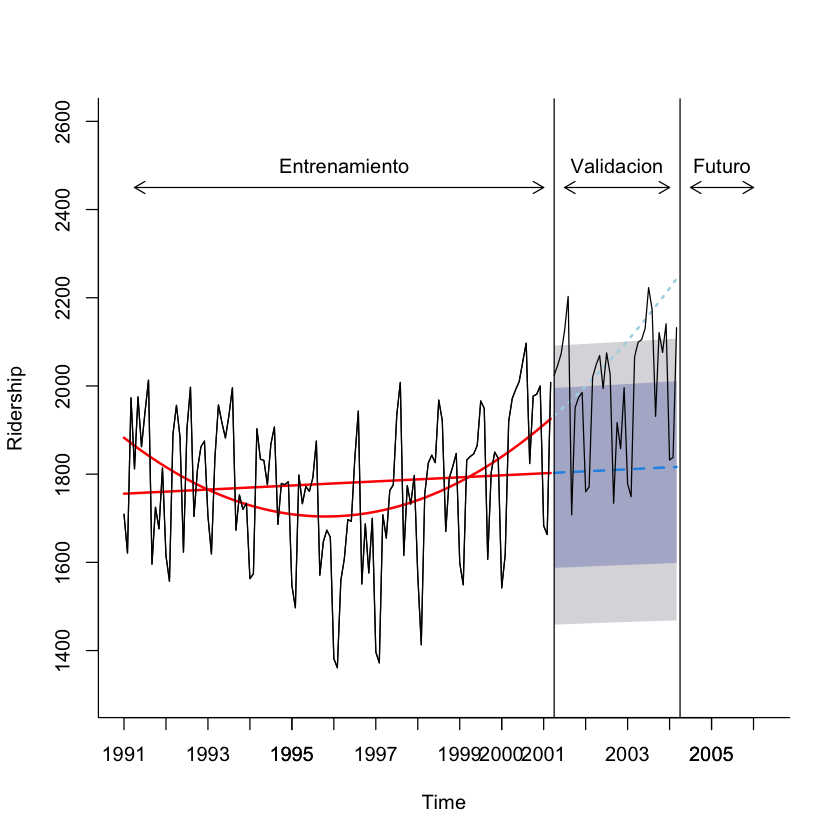

In [38]:
entren.lm.poli.pred = forecast(entren.lm.poli, h=nValid)
plot(entren.lm.pred, ylim=c(1300,2600), ylab="Ridership", xlab="Time", bty="l", xlim=c(1991,2006.25), main="", flty=2)
axis(1, at=seq(1991,2006,1), labels=format(seq(1991,2006,1)))
lines(entren.lm.pred$fitted, lwd=2,col="red")
lines(entren.lm.poli.pred$fitted, lwd=2,col="red")
lines(entren.lm.poli.pred$mean, lwd = 2,lty = 3, col="lightblue")
lines(valid.ts)
lines(entren.ts)
lines(c(2004.25 - 3, 2004.25 - 3), c(0, 3500)) 
lines(c(2004.25, 2004.25), c(0, 3500))
text(1996.25, 2500, "Entrenamiento")
text(2002.75, 2500, "Validacion")
text(2005.25, 2500, "Futuro")
arrows(2004 - 3, 2450, 1991.25, 2450, code = 3, length = 0.1, lwd = 1,angle = 30)
arrows(2004.5 - 3, 2450, 2004, 2450, code = 3, length = 0.1, lwd = 1,angle = 30)
arrows(2004.5, 2450, 2006, 2450, code = 3, length = 0.1, lwd = 1, angle = 30)


Vemos que este modelo mejoró ante el anterior que sólamente incluía una tendencia lineal. Sin embargo, podemos incluir el componente de estacionalidad, que no ha sido considerado al momento.

<a id="9"></a> <br>
### H. Modelos con estacionalidad

Retomaremos el modelo anterior e incluiremos el componente de la estacionalidad, cuyo feature es relevante a partir de la visualización de la descomposición de la sere.

In [39]:
entren.lm.season <-tslm(entren.ts~season)  #notar que season es con minuscula, no es el nombre de la columna del mes.
summary(entren.lm.season)


Call:
tslm(formula = entren.ts ~ season)

Residuals:
   Min     1Q Median     3Q    Max 
-275.9  -52.6    5.9   54.4  214.7 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  1573.91      30.56  51.501  < 2e-16 ***
season2       -42.73      43.22  -0.989   0.3250    
season3       261.00      43.22   6.039 2.11e-08 ***
season4       245.19      44.29   5.536 2.09e-07 ***
season5       278.19      44.29   6.282 6.72e-09 ***
season6       233.49      44.29   5.272 6.71e-07 ***
season7       345.49      44.29   7.801 3.63e-12 ***
season8       396.79      44.29   8.960 8.82e-15 ***
season9        75.89      44.29   1.714   0.0894 .  
season10      200.79      44.29   4.534 1.47e-05 ***
season11      192.39      44.29   4.344 3.11e-05 ***
season12      230.39      44.29   5.202 9.09e-07 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 101.4 on 111 degrees of freedom
Multiple R-squared:  0.635,	Adjusted R-square

<a id="10"></a> <br>
### I. Modelos con todos los componentes

Incluyamos ahora, todos los componentes en el modelo de regresión:

In [40]:
entren.lm.compo <-tslm(entren.ts~trend+I(trend^2)+season)  #notar que season es con minúscula, no es el nombre de la columna del mes.
summary(entren.lm.compo)


Call:
tslm(formula = entren.ts ~ trend + I(trend^2) + season)

Residuals:
     Min       1Q   Median       3Q      Max 
-213.811  -39.478    9.719   42.458  152.073 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  1.697e+03  2.766e+01  61.350  < 2e-16 ***
trend       -7.154e+00  7.289e-01  -9.815  < 2e-16 ***
I(trend^2)   6.072e-02  5.695e-03  10.661  < 2e-16 ***
season2     -4.304e+01  3.022e+01  -1.424  0.15727    
season3      2.602e+02  3.023e+01   8.610 6.19e-14 ***
season4      2.607e+02  3.100e+01   8.409 1.76e-13 ***
season5      2.938e+02  3.100e+01   9.475 6.74e-16 ***
season6      2.490e+02  3.100e+01   8.031 1.23e-12 ***
season7      3.608e+02  3.100e+01  11.637  < 2e-16 ***
season8      4.118e+02  3.100e+01  13.282  < 2e-16 ***
season9      9.044e+01  3.101e+01   2.917  0.00429 ** 
season10     2.148e+02  3.101e+01   6.927 3.14e-10 ***
season11     2.057e+02  3.101e+01   6.634 1.31e-09 ***
season12     2.429e+02  3.101e+01   7.833 3.38e-

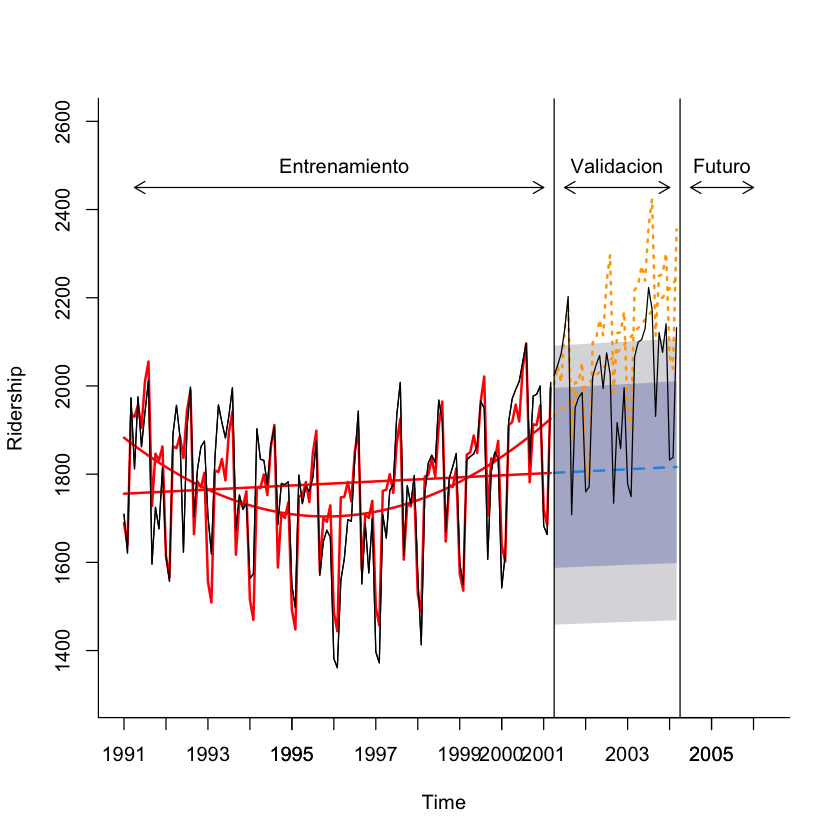

In [41]:
#Generamos su visualización:
entren.lm.compo.pre = forecast(entren.lm.compo, h=nValid)
plot(entren.lm.pred, ylim=c(1300,2600), ylab="Ridership", xlab="Time", bty="l", xlim=c(1991,2006.25), main="", flty=2)
axis(1, at=seq(1991,2006,1), labels=format(seq(1991,2006,1)))
lines(entren.lm.pred$fitted, lwd=2,col="red")
lines(entren.lm.poli.pred$fitted, lwd=2,col="red")
lines(entren.lm.poli.pred$mean, lwd = 2,lty = 3, col="orange")
lines(entren.lm.compo.pre$fitted, lwd=2,col="red")
lines(entren.lm.compo.pre$mean, lwd = 2,lty = 3, col="orange")
lines(valid.ts)
lines(entren.ts)
lines(c(2004.25 - 3, 2004.25 - 3), c(0, 3500)) 
lines(c(2004.25, 2004.25), c(0, 3500))
text(1996.25, 2500, "Entrenamiento")
text(2002.75, 2500, "Validacion")
text(2005.25, 2500, "Futuro")
arrows(2004 - 3, 2450, 1991.25, 2450, code = 3, length = 0.1, lwd = 1,angle = 30)
arrows(2004.5 - 3, 2450, 2004, 2450, code = 3, length = 0.1, lwd = 1,angle = 30)
arrows(2004.5, 2450, 2006, 2450, code = 3, length = 0.1, lwd = 1, angle = 30)


Vemos que este último modelo genera un mejor ajuste a los datos. Ante ello, procedemos a la obtención de métricas de error, para conocer la precisión del pronóstico empleando el conjunto de datos de prueba.

<a id="11"></a> <br>
### J. Obtención de métricas de error

Ahora, calculemos las métricas de RMSE y MAPE, como ejemplos de métricas de error de escala y porcentual en el pronóstico de los datos de prueba.

In [44]:
#Métricas:
library(Metrics)
rmse_tslm_poli<-rmse(valid.ts, entren.lm.compo.pre$mean)
rmse_tslm_poli
mape_tslm_poli<-mape(valid.ts, entren.lm.compo.pre$mean)
mape_tslm_poli


Attaching package: ‘Metrics’


The following object is masked from ‘package:smooth’:

    accuracy


The following object is masked from ‘package:greybox’:

    accuracy


The following objects are masked from ‘package:yardstick’:

    accuracy, mae, mape, mase, precision, recall, rmse, smape


The following object is masked from ‘package:fabletools’:

    accuracy


The following object is masked from ‘package:forecast’:

    accuracy




[1] 153.1258

[1] 0.06691712

<a id="12"></a> <br>
### K.Generación del pronóstico hacia adelante

Para el pronóstico forward o futuro, generamos la función de ajuste a todos los datos de la serie e ingresando todos los componentes de la serie, incluyendo el término cuadrático que resultó ser relevante. Es importante recalcar que en esta situación, no debemos generar los features ya que la función lo genera de manera automática.

In [45]:
# Aplicamos función tslm()
lm_all <-tslm(df.ts~trend+I(trend^2)+season)  #notar que season es con minúscula, no es el nombre de la columna del mes.
summary(lm_all)


Call:
tslm(formula = df.ts ~ trend + I(trend^2) + season)

Residuals:
    Min      1Q  Median      3Q     Max 
-219.54  -39.10   10.37   45.20  146.30 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  1.656e+03  2.510e+01  65.987  < 2e-16 ***
trend       -4.939e+00  5.063e-01  -9.756  < 2e-16 ***
I(trend^2)   4.126e-02  3.065e-03  13.459  < 2e-16 ***
season2     -3.605e+01  2.745e+01  -1.313   0.1912    
season3      2.623e+02  2.745e+01   9.556  < 2e-16 ***
season4      2.715e+02  2.799e+01   9.700  < 2e-16 ***
season5      2.994e+02  2.799e+01  10.695  < 2e-16 ***
season6      2.617e+02  2.799e+01   9.349  < 2e-16 ***
season7      3.638e+02  2.799e+01  12.999  < 2e-16 ***
season8      4.001e+02  2.799e+01  14.293  < 2e-16 ***
season9      7.221e+01  2.799e+01   2.580   0.0109 *  
season10     2.139e+02  2.799e+01   7.641 2.70e-12 ***
season11     1.993e+02  2.799e+01   7.120 4.62e-11 ***
season12     2.431e+02  2.800e+01   8.682 7.36e-15 ***
---
Sig

Como vemos, los resultados son muy similares a los obtenidos por la función de lm(). Generamos entonces, el pronóstico a través de la función forecast(), indicando los pasos a pronosticar. Esto quiere decir que el modelo emplea los últimos 30 datos para generar los 30 datos futuros, aplicados al modelo de regresión.

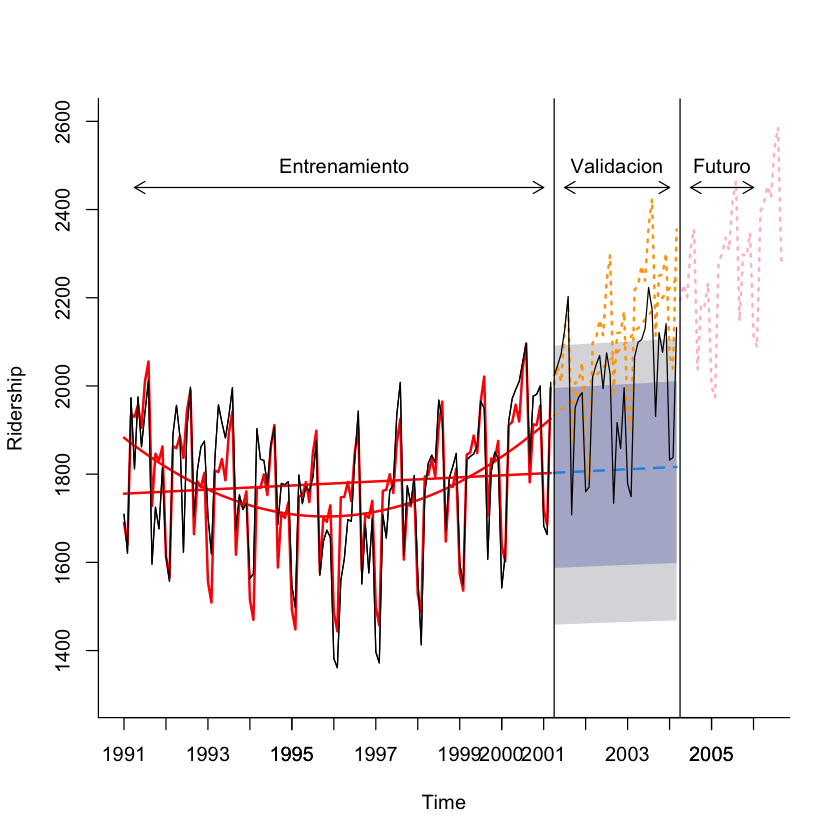

In [46]:
# Generamos su visualizaicón:
pron_fwd = forecast(lm_all, h=30)
plot(entren.lm.pred, ylim=c(1300,2600), ylab="Ridership", xlab="Time", bty="l", xlim=c(1991,2006.25), main="", flty=2)
axis(1, at=seq(1991,2006,1), labels=format(seq(1991,2006,1)))
lines(entren.lm.pred$fitted, lwd=2,col="red")
lines(entren.lm.poli.pred$fitted, lwd=2,col="red")
lines(entren.lm.poli.pred$mean, lwd = 2,lty = 3, col="orange")
lines(entren.lm.compo.pre$fitted, lwd=2,col="red")
lines(entren.lm.compo.pre$mean, lwd = 2,lty = 3, col="orange")
lines(pron_fwd$mean, lwd = 2,lty = 3, col="pink") ##Futuro: FWD Forecast
lines(valid.ts)
lines(entren.ts)
lines(c(2004.25 - 3, 2004.25 - 3), c(0, 3500)) 
lines(c(2004.25, 2004.25), c(0, 3500))
text(1996.25, 2500, "Entrenamiento")
text(2002.75, 2500, "Validacion")
text(2005.25, 2500, "Futuro")
arrows(2004 - 3, 2450, 1991.25, 2450, code = 3, length = 0.1, lwd = 1,angle = 30)
arrows(2004.5 - 3, 2450, 2004, 2450, code = 3, length = 0.1, lwd = 1,angle = 30)
arrows(2004.5, 2450, 2006, 2450, code = 3, length = 0.1, lwd = 1, angle = 30)

De esta manera, vemos que se obtienen muy buenos resultados a través de la aplicación de esta función.

Ahora veamos, otra manera de realizar el modelamiento, que es a través de la función de lm() y porteriormente de ModelTime.

<a id="13"></a> <br>
# Modelación con función lm()

Ahora, probemos un tipo de modelamiento a través de la función lm() tradicional. Para ello, deberemos capturar los features de la serie, usualmente se generan estos a través de funciones de retrasos o lag(), así como la generación de tendencias las cuales van cambiando unidad por unidad. Esta generación de features se va dando a manera de ir formando nuenvas columnas.


<a id="14"></a> <br>
### A. Importación de datos

Incluyo estos pasos ya previamente realizados, pero para facilidad de lectura en el ejercicio, rellamemos a los datos, indexemos la fecha.

In [47]:
# Importamos los datos:
df<-read.csv("./Amtrak_data.csv", sep=";", header=TRUE)
head(df)

,Month,Ridership,Season,t
,<chr>,<int>,<chr>,<int>
1,01/01/1991,1709,Jan,1
2,01/02/1991,1621,Feb,2
3,01/03/1991,1973,Mar,3
4,01/04/1991,1812,Apr,4
5,01/05/1991,1975,May,5
6,01/06/1991,1862,Jun,6


In [48]:
# GEneramos la columna de date
df$Date<- as.Date(df$Month, format='%d/%m/%Y')
str(df)
head(df)

'data.frame':	159 obs. of  5 variables:
 $ Month    : chr  "01/01/1991" "01/02/1991" "01/03/1991" "01/04/1991" ...
 $ Ridership: int  1709 1621 1973 1812 1975 1862 1940 2013 1596 1725 ...
 $ Season   : chr  "Jan" "Feb" "Mar" "Apr" ...
 $ t        : int  1 2 3 4 5 6 7 8 9 10 ...
 $ Date     : Date, format: "1991-01-01" "1991-02-01" ...


,Month,Ridership,Season,t,Date
,<chr>,<int>,<chr>,<int>,<date>
1,01/01/1991,1709,Jan,1,1991-01-01
2,01/02/1991,1621,Feb,2,1991-02-01
3,01/03/1991,1973,Mar,3,1991-03-01
4,01/04/1991,1812,Apr,4,1991-04-01
5,01/05/1991,1975,May,5,1991-05-01
6,01/06/1991,1862,Jun,6,1991-06-01


In [51]:
#Esta librería es útil para la generación de rezagos:
library(DataCombine)

Y generamos los features, rezagos correspondientes.

In [52]:
# Generamos los rezagos:
df1 <- slide(df, Var = "Ridership", slideBy = -1) 
df2 <- slide(df1, Var = "Ridership", slideBy = -2) 
df3 <- slide(df2, Var = "Ridership", slideBy = -3) 
df4 <- slide(df3, Var = "Ridership", slideBy = -4) 
df5 <- slide(df4, Var = "Ridership", slideBy = -5)
df6 <- slide(df5, Var = "Ridership", slideBy = -6) %>%na.omit()
colnames(df6) <- c("Month", "Ridership","Season","t", "Date", "l1", "l2", "l3", "l4",  "l5", "l6")
tail(df6)


Remember to put df in time order before running.


Lagging Ridership by 1 time units.



Remember to put df1 in time order before running.


Lagging Ridership by 2 time units.



Remember to put df2 in time order before running.


Lagging Ridership by 3 time units.



Remember to put df3 in time order before running.


Lagging Ridership by 4 time units.



Remember to put df4 in time order before running.


Lagging Ridership by 5 time units.



Remember to put df5 in time order before running.


Lagging Ridership by 6 time units.




,Month,Ridership,Season,t,Date,l1,l2,l3,l4,l5,l6
,<chr>,<int>,<chr>,<int>,<date>,<int>,<int>,<int>,<int>,<int>,<int>
154,01/10/2003,2121,Oct,154,2003-10-01,1931,2174,2223,2130,2105,2099
155,01/11/2003,2076,Nov,155,2003-11-01,2121,1931,2174,2223,2130,2105
156,01/12/2003,2141,Dec,156,2003-12-01,2076,2121,1931,2174,2223,2130
157,01/01/2004,1832,Jan,157,2004-01-01,2141,2076,2121,1931,2174,2223
158,01/02/2004,1838,Feb,158,2004-02-01,1832,2141,2076,2121,1931,2174
159,01/03/2004,2132,Mar,159,2004-03-01,1838,1832,2141,2076,2121,1931


In [53]:
# Agregamos la tendencia:
df6$trend = 1:nrow(df6)
df6$trend2 = df6$trend^2
#df.ts$trend3 = 1:nrow(df.ts)$trend^3 # si se requiriera una tendencia cúbica
str(df6)
head(df6)
tail(df6)

'data.frame':	153 obs. of  13 variables:
 $ Month    : chr  "01/07/1991" "01/08/1991" "01/09/1991" "01/10/1991" ...
 $ Ridership: int  1940 2013 1596 1725 1676 1814 1615 1557 1891 1956 ...
 $ Season   : chr  "Jul" "Aug" "Sep" "Oct" ...
 $ t        : int  7 8 9 10 11 12 13 14 15 16 ...
 $ Date     : Date, format: "1991-07-01" "1991-08-01" ...
 $ l1       : int  1862 1940 2013 1596 1725 1676 1814 1615 1557 1891 ...
 $ l2       : int  1975 1862 1940 2013 1596 1725 1676 1814 1615 1557 ...
 $ l3       : int  1812 1975 1862 1940 2013 1596 1725 1676 1814 1615 ...
 $ l4       : int  1973 1812 1975 1862 1940 2013 1596 1725 1676 1814 ...
 $ l5       : int  1621 1973 1812 1975 1862 1940 2013 1596 1725 1676 ...
 $ l6       : int  1709 1621 1973 1812 1975 1862 1940 2013 1596 1725 ...
 $ trend    : int  1 2 3 4 5 6 7 8 9 10 ...
 $ trend2   : num  1 4 9 16 25 36 49 64 81 100 ...
 - attr(*, "na.action")= 'omit' Named int [1:6] 1 2 3 4 5 6
  ..- attr(*, "names")= chr [1:6] "1" "2" "3" "4" ...


,Month,Ridership,Season,t,Date,l1,l2,l3,l4,l5,l6,trend,trend2
,<chr>,<int>,<chr>,<int>,<date>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>
7,01/07/1991,1940,Jul,7,1991-07-01,1862,1975,1812,1973,1621,1709,1,1
8,01/08/1991,2013,Aug,8,1991-08-01,1940,1862,1975,1812,1973,1621,2,4
9,01/09/1991,1596,Sep,9,1991-09-01,2013,1940,1862,1975,1812,1973,3,9
10,01/10/1991,1725,Oct,10,1991-10-01,1596,2013,1940,1862,1975,1812,4,16
11,01/11/1991,1676,Nov,11,1991-11-01,1725,1596,2013,1940,1862,1975,5,25
12,01/12/1991,1814,Dec,12,1991-12-01,1676,1725,1596,2013,1940,1862,6,36


,Month,Ridership,Season,t,Date,l1,l2,l3,l4,l5,l6,trend,trend2
,<chr>,<int>,<chr>,<int>,<date>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>
154,01/10/2003,2121,Oct,154,2003-10-01,1931,2174,2223,2130,2105,2099,148,21904
155,01/11/2003,2076,Nov,155,2003-11-01,2121,1931,2174,2223,2130,2105,149,22201
156,01/12/2003,2141,Dec,156,2003-12-01,2076,2121,1931,2174,2223,2130,150,22500
157,01/01/2004,1832,Jan,157,2004-01-01,2141,2076,2121,1931,2174,2223,151,22801
158,01/02/2004,1838,Feb,158,2004-02-01,1832,2141,2076,2121,1931,2174,152,23104
159,01/03/2004,2132,Mar,159,2004-03-01,1838,1832,2141,2076,2121,1931,153,23409


In [54]:
# Por facilidad, puedes renombrar el objeto.
ldf<-df6

<a id="15"></a> <br>
### B.Partición datos de entrenamiento y prueba

En esta parte, vamos a considerar el mismo horizonte del pronóstico empleado en el modelo con tslm().

In [55]:
##h: horizonte pronostico
h <- 36
ldf_train <- ldf[1:(nrow(ldf) - h), ]
ldf_test<- ldf[(nrow(ldf) - h + 1):nrow(ldf), ]
tail(ldf_train)
head(ldf_test)

,Month,Ridership,Season,t,Date,l1,l2,l3,l4,l5,l6,trend,trend2
,<chr>,<int>,<chr>,<int>,<date>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>
118,01/10/2000,1977,Oct,118,2000-10-01,1824,2097,2054,2010,1992,1971,112,12544
119,01/11/2000,1981,Nov,119,2000-11-01,1977,1824,2097,2054,2010,1992,113,12769
120,01/12/2000,2000,Dec,120,2000-12-01,1981,1977,1824,2097,2054,2010,114,12996
121,01/01/2001,1683,Jan,121,2001-01-01,2000,1981,1977,1824,2097,2054,115,13225
122,01/02/2001,1663,Feb,122,2001-02-01,1683,2000,1981,1977,1824,2097,116,13456
123,01/03/2001,2008,Mar,123,2001-03-01,1663,1683,2000,1981,1977,1824,117,13689


,Month,Ridership,Season,t,Date,l1,l2,l3,l4,l5,l6,trend,trend2
,<chr>,<int>,<chr>,<int>,<date>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>
124,01/04/2001,2024,Apr,124,2001-04-01,2008,1663,1683,2000,1981,1977,118,13924
125,01/05/2001,2047,May,125,2001-05-01,2024,2008,1663,1683,2000,1981,119,14161
126,01/06/2001,2073,Jun,126,2001-06-01,2047,2024,2008,1663,1683,2000,120,14400
127,01/07/2001,2127,Jul,127,2001-07-01,2073,2047,2024,2008,1663,1683,121,14641
128,01/08/2001,2203,Aug,128,2001-08-01,2127,2073,2047,2024,2008,1663,122,14884
129,01/09/2001,1708,Sep,129,2001-09-01,2203,2127,2073,2047,2024,2008,123,15129


<a id="16"></a> <br>
### C. Especificación del modelo lineal con lm()

Una vez creada la base de datos con los features, procedemos a emplear la función lm().

In [56]:
####Modelo de referencia: Modelo lineal
lm_ldf <- lm(Ridership ~ l1 + l2  + l3 + l4 +l5 +l6 + trend + trend2, data = ldf_train)
summary(lm_ldf)
#Vemos que varios features no son relevantes, por ello, depuramos el modelo.


Call:
lm(formula = Ridership ~ l1 + l2 + l3 + l4 + l5 + l6 + trend + 
    trend2, data = ldf_train)

Residuals:
    Min      1Q  Median      3Q     Max 
-302.97  -64.27   10.80   77.14  180.23 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept) 2325.41516  250.29517   9.291 1.91e-15 ***
l1             0.27587    0.07561   3.649 0.000408 ***
l2            -0.03646    0.08048  -0.453 0.651451    
l3             0.02303    0.07978   0.289 0.773349    
l4             0.12054    0.07921   1.522 0.130993    
l5             0.00359    0.07877   0.046 0.963729    
l6            -0.62259    0.07500  -8.302 3.22e-13 ***
trend         -8.01490    1.49585  -5.358 4.80e-07 ***
trend2         0.07198    0.01262   5.702 1.04e-07 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 106 on 108 degrees of freedom
Multiple R-squared:  0.5961,	Adjusted R-squared:  0.5662 
F-statistic: 19.93 on 8 and 108 DF,  p-value: < 2.2e-16


In [57]:
####Modelo depurado:
lm_ldf2 <- lm(Ridership ~ l1+l6 + trend + trend2, data = ldf_train)
summary(lm_ldf2)


Call:
lm(formula = Ridership ~ l1 + l6 + trend + trend2, data = ldf_train)

Residuals:
    Min      1Q  Median      3Q     Max 
-305.96  -71.56   15.77   84.41  196.57 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept) 2553.91445  195.19106  13.084  < 2e-16 ***
l1             0.26691    0.06743   3.959 0.000133 ***
l6            -0.62188    0.06762  -9.197 2.36e-15 ***
trend         -8.95393    1.34855  -6.640 1.17e-09 ***
trend2         0.08013    0.01127   7.108 1.16e-10 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 105.9 on 112 degrees of freedom
Multiple R-squared:  0.5819,	Adjusted R-squared:  0.567 
F-statistic: 38.97 on 4 and 112 DF,  p-value: < 2.2e-16


<a id="17"></a> <br>
### D. Predicción con datos prueba

En esta sección aplicamos la función de predict(), aplicando el modelo depurado, especificando que es una serie de tiempo con "ts=TRUE".

In [58]:
# Generamos una columna con los resultados del modelo de predicción  que llamamos "yhat".
ldf_test$yhat <- predict(lm_ldf2, newdata = ldf_test, ts=TRUE)
head(ldf_test)
str(ldf_test)

,Month,Ridership,Season,t,Date,l1,l2,l3,l4,l5,l6,trend,trend2,yhat
,<chr>,<int>,<chr>,<int>,<date>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>,<dbl>
124,01/04/2001,2024,Apr,124,2001-04-01,2008,1663,1683,2000,1981,1977,118,13924,1919.598
125,01/05/2001,2047,May,125,2001-05-01,2024,2008,1663,1683,2000,1981,119,14161,1931.418
126,01/06/2001,2073,Jun,126,2001-06-01,2047,2024,2008,1663,1683,2000,120,14400,1935.939
127,01/07/2001,2127,Jul,127,2001-07-01,2073,2047,2024,2008,1663,1683,121,14641,2150.373
128,01/08/2001,2203,Aug,128,2001-08-01,2127,2073,2047,2024,2008,1663,122,14884,2187.741
129,01/09/2001,1708,Sep,129,2001-09-01,2203,2127,2073,2047,2024,2008,123,15129,2004.156


'data.frame':	36 obs. of  14 variables:
 $ Month    : chr  "01/04/2001" "01/05/2001" "01/06/2001" "01/07/2001" ...
 $ Ridership: int  2024 2047 2073 2127 2203 1708 1951 1974 1985 1760 ...
 $ Season   : chr  "Apr" "May" "Jun" "Jul" ...
 $ t        : int  124 125 126 127 128 129 130 131 132 133 ...
 $ Date     : Date, format: "2001-04-01" "2001-05-01" ...
 $ l1       : int  2008 2024 2047 2073 2127 2203 1708 1951 1974 1985 ...
 $ l2       : int  1663 2008 2024 2047 2073 2127 2203 1708 1951 1974 ...
 $ l3       : int  1683 1663 2008 2024 2047 2073 2127 2203 1708 1951 ...
 $ l4       : int  2000 1683 1663 2008 2024 2047 2073 2127 2203 1708 ...
 $ l5       : int  1981 2000 1683 1663 2008 2024 2047 2073 2127 2203 ...
 $ l6       : int  1977 1981 2000 1683 1663 2008 2024 2047 2073 2127 ...
 $ trend    : int  118 119 120 121 122 123 124 125 126 127 ...
 $ trend2   : num  13924 14161 14400 14641 14884 ...
 $ yhat     : num  1920 1931 1936 2150 2188 ...
 - attr(*, "na.action")= 'omit' Named int 

Grafiquemos los resultados empleado la función de plotly, especificando las fechas de estudio mediante la generación de fechas en formato "as.Date", indicando qué elementos son de eje "x" o fechas y cuáles de "y". En el resto de líneas, agregamos los resultados de pronóstico en el conjunto de datos de prueba.

In [59]:
# Llamamos primeramente la librería y procedemos a indicar las características de la visualización.
library(plotly)
start<-format(as.Date("1991-01-01"),"%Y-%m-%d")
end<-format(as.Date("2004-03-01"),"%Y-%m-%d")
plot_ly(x = ldf$Date, y = ldf$Ridership,
        type = "scatter",
        mode = "line", 
        name = "Actual") %>% 
  add_lines(x = ldf_test$Date, y = ldf_test$yhat, name = "LM") %>%
  layout(title = "LM Forecast", yaxis = list(title = "Ridership @ Los Andes", range = c(1000, 3000)),
         xaxis = list(title = "Date", range = c(start, end)))


Attaching package: ‘plotly’


The following object is masked from ‘package:ggplot2’:

    last_plot


The following object is masked from ‘package:stats’:

    filter


The following object is masked from ‘package:graphics’:

    layout




HTML widgets cannot be represented in plain text (need html)

<a id="18"></a> <br>
### E. Obtención de métricas de error

Una vez generado el pronóstico en los datos de prueba, podemos medir la precisión de los resultados mediante métricos de error. Usualmente empleamos métricos de escala y de porcentaje, tales como el RMSE y el MAPE, respectivamente. 

In [60]:
# Comenzamos con la importación de la librería Metrics.
library(Metrics)
mape_lm_ldf <- mape(ldf_test$Ridership, ldf_test$yhat)
mape_lm_ldf
rmse_lm_ldf <- rmse(ldf_test$Ridership, ldf_test$yhat)
rmse_lm_ldf

[1] 0.08428536

[1] 195.5864

In [61]:
# Podemos comparar con las métricas obtenidas con tslm():
mape_tslm_poli
rmse_tslm_poli

[1] 0.06691712

[1] 153.1258

El algoritmo de tslm ofrece mejores desempeños.

<a id="19"></a> <br>
### F. Generación de pronóstico hacia adelante
Primero, generamos un ajuste a toda la serie para obtener la ecuación model; para ello, debemos generar nuevamente todos los features para el modelo lm(). Posteriormente, aplicamos función predict.lm, que emplea los datos de ajuste para generar el pronóstico.

In [62]:
# Retomamos los datos iniciales en formato data frame:
head(df)

,Month,Ridership,Season,t,Date
,<chr>,<int>,<chr>,<int>,<date>
1,01/01/1991,1709,Jan,1,1991-01-01
2,01/02/1991,1621,Feb,2,1991-02-01
3,01/03/1991,1973,Mar,3,1991-03-01
4,01/04/1991,1812,Apr,4,1991-04-01
5,01/05/1991,1975,May,5,1991-05-01
6,01/06/1991,1862,Jun,6,1991-06-01


In [63]:
# Generamos los rezagos a toda la base
df1f <- slide(df, Var = "Ridership", slideBy = -1) 
df2f <- slide(df1f, Var = "Ridership", slideBy = -2) 
df3f <- slide(df2f, Var = "Ridership", slideBy = -3) 
df4f <- slide(df3f, Var = "Ridership", slideBy = -4) 
df5f <- slide(df4f, Var = "Ridership", slideBy = -5)
df6f <- slide(df5f, Var = "Ridership", slideBy = -6) %>%na.omit()
colnames(df6f) <- c("Month", "Ridership","Season","t", "Date", "l1", "l2", "l3", "l4",  "l5", "l6")



Remember to put df in time order before running.


Lagging Ridership by 1 time units.



Remember to put df1f in time order before running.


Lagging Ridership by 2 time units.



Remember to put df2f in time order before running.


Lagging Ridership by 3 time units.



Remember to put df3f in time order before running.


Lagging Ridership by 4 time units.



Remember to put df4f in time order before running.


Lagging Ridership by 5 time units.



Remember to put df5f in time order before running.


Lagging Ridership by 6 time units.




In [64]:
# Generamos los features de tendencia lineal y cuadrática.
tail(df6f)
df6f$trend = 1:nrow(df6f)
df6f$trend2 = df6f$trend^2
#df.ts$trend3 = 1:nrow(df.ts)$trend^3 # si se requiriera un atendencia cúbica
str(df6f)
#tail(df6f)

,Month,Ridership,Season,t,Date,l1,l2,l3,l4,l5,l6
,<chr>,<int>,<chr>,<int>,<date>,<int>,<int>,<int>,<int>,<int>,<int>
154,01/10/2003,2121,Oct,154,2003-10-01,1931,2174,2223,2130,2105,2099
155,01/11/2003,2076,Nov,155,2003-11-01,2121,1931,2174,2223,2130,2105
156,01/12/2003,2141,Dec,156,2003-12-01,2076,2121,1931,2174,2223,2130
157,01/01/2004,1832,Jan,157,2004-01-01,2141,2076,2121,1931,2174,2223
158,01/02/2004,1838,Feb,158,2004-02-01,1832,2141,2076,2121,1931,2174
159,01/03/2004,2132,Mar,159,2004-03-01,1838,1832,2141,2076,2121,1931


'data.frame':	153 obs. of  13 variables:
 $ Month    : chr  "01/07/1991" "01/08/1991" "01/09/1991" "01/10/1991" ...
 $ Ridership: int  1940 2013 1596 1725 1676 1814 1615 1557 1891 1956 ...
 $ Season   : chr  "Jul" "Aug" "Sep" "Oct" ...
 $ t        : int  7 8 9 10 11 12 13 14 15 16 ...
 $ Date     : Date, format: "1991-07-01" "1991-08-01" ...
 $ l1       : int  1862 1940 2013 1596 1725 1676 1814 1615 1557 1891 ...
 $ l2       : int  1975 1862 1940 2013 1596 1725 1676 1814 1615 1557 ...
 $ l3       : int  1812 1975 1862 1940 2013 1596 1725 1676 1814 1615 ...
 $ l4       : int  1973 1812 1975 1862 1940 2013 1596 1725 1676 1814 ...
 $ l5       : int  1621 1973 1812 1975 1862 1940 2013 1596 1725 1676 ...
 $ l6       : int  1709 1621 1973 1812 1975 1862 1940 2013 1596 1725 ...
 $ trend    : int  1 2 3 4 5 6 7 8 9 10 ...
 $ trend2   : num  1 4 9 16 25 36 49 64 81 100 ...
 - attr(*, "na.action")= 'omit' Named int [1:6] 1 2 3 4 5 6
  ..- attr(*, "names")= chr [1:6] "1" "2" "3" "4" ...


In [65]:
# Generamos el modelo de regresión con lm()
lm_df6f<-lm(Ridership ~ l1 + l2  + l3 + l4 +l5 +l6 + trend + trend2, data = df6f)
summary(lm_df6f)


Call:
lm(formula = Ridership ~ l1 + l2 + l3 + l4 + l5 + l6 + trend + 
    trend2, data = df6f)

Residuals:
    Min      1Q  Median      3Q     Max 
-328.96  -63.84   11.59   78.41  234.22 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)  2.107e+03  2.175e+02   9.688  < 2e-16 ***
l1           2.981e-01  6.792e-02   4.388 2.20e-05 ***
l2          -1.159e-02  7.239e-02  -0.160   0.8730    
l3           7.273e-03  7.173e-02   0.101   0.9194    
l4           1.382e-01  7.126e-02   1.940   0.0544 .  
l5           6.721e-03  7.150e-02   0.094   0.9252    
l6          -5.817e-01  6.772e-02  -8.590 1.30e-14 ***
trend       -5.031e+00  9.970e-01  -5.046 1.34e-06 ***
trend2       4.556e-02  7.128e-03   6.391 2.15e-09 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 110.9 on 144 degrees of freedom
Multiple R-squared:  0.6532,	Adjusted R-squared:  0.6339 
F-statistic:  33.9 on 8 and 144 DF,  p-value: < 2.2e-16


Para poder generar pronósticos futuros, se debe aplicar el modelo a una estructura de datos donde se tomen los últimos valores para predecir los futuros. Una vez generados, podemos crear la secuencia de fechas para estos mediante la función seq(), que ayudará a la visualización.

In [66]:
# Generamos el pronóstico hacia adelante
lm_fwd <- predict.lm(lm_df6f, interval = "prediction")[118:153,]
head(lm_fwd)
tail(lm_fwd)

,fit,lwr,upr
124,1879.315,1653.144,2105.486
125,1839.690,1614.284,2065.096
126,1838.779,1612.141,2065.416
127,2084.279,1858.666,2309.892
128,2122.444,1896.772,2348.116
129,1953.388,1728.064,2178.711


,fit,lwr,upr
154,2014.814,1788.942,2240.686
155,2091.938,1865.131,2318.746
156,2062.456,1835.371,2289.540
157,2004.399,1776.835,2231.963
158,1973.122,1743.699,2202.546
159,2124.241,1893.437,2355.045


In [67]:
# Generamos la secuencia de fechas a dichos valores
starter_df <- data.frame(dates=seq(from=(as.POSIXct(strftime("2004-04-01"))),
                               length.out = 36, 
                               by="1 month"),
                     data = lm_fwd)

In [68]:
# Asignamos a esas fechas un formato requerido para el gráfico
full_data <- data.frame(dates=seq(from=min(starter_df$dates),
to=max(starter_df$dates), by="1 month"),
data=rep(NA,NROW(seq(from=min(starter_df$dates),
to=max(starter_df$dates), by="1 month"))))

full_data[full_data$dates %in% starter_df$dates,] <- starter_df[starter_df$dates %in% full_data$dates,]
head(full_data)

,dates,data
,<dttm>,<dbl>
1,2004-04-01,1879.315
2,2004-05-01,1839.690
3,2004-06-01,1838.779
4,2004-07-01,2084.279
5,2004-08-01,2122.444
6,2004-09-01,1953.388


In [69]:
# Gráfico:
library(plotly)
start<-format(as.Date("1991-01-01"),"%Y-%m-%d")
end<-format(as.Date("2005-02-01"),"%Y-%m-%d")
plot_ly(x = ldf$Date, y = ldf$Ridership,
        type = "scatter",
        mode = "line", 
        name = "Actual") %>% 
  add_lines(x = ldf_test$Date, y = ldf_test$yhat, name = "LM") %>%
  add_lines(x = full_data$dates, y = full_data$data, name = "LM FWD") %>%
  layout(title = "LM Forecast", yaxis = list(title = "Ridership @ Los Andes", range = c(1000, 3000)),
         xaxis = list(title = "Date", range = c(start, end)))

HTML widgets cannot be represented in plain text (need html)

<a id="20"></a> <br>
## 3. Modelación con TimeModel()

Como es usual en el manejo de funciones que involucran series de tiempo, al aemplear esta paquetería es necesario convertir los datos en formato data frame. Posteriormente, vamos a partir la serie en conjunto de entrenamiento y prueba mediante la función de time_series_split(). Posteriormente, camos a definir modelo para después adicionarlo a un formato de TimeTable. Lo vamos a calibrar que significa que el modelo se va a aplicar a toda la serie y va a generar ajustes al mismo para así obtener el modelo final; posteriormente procederemos con el cálculo de los métricos de error de pronóstico. Finalmente, aplicaremos la función de pronóstico futuro.

<a id="21"></a> <br>
### A. Partición de datos en entrenamiento y prueba

Comencemos partiendo la serie. Este paso usualmente debiera ser el que procede a la importación de datos, el cual ya hemos realizado previamente.

In [70]:
# La función de time_series_split genera en un solo paso, la partición de la serie, especificando el periodo respectivo para la prueba.
splits <- df %>%
  time_series_split(assess = "36 months", cumulative = TRUE)

Using date_var: Date



In [71]:
# Podemos visualiar la serie con el conjunto de entrenamiento y de prueba, además, adicionando una lpinea de suavizamiento a la tendecia. 
# Podemos también solicitar que la visualización sea interactiva o no. En este caso, optamos por interactiva.
splits %>%
  tk_time_series_cv_plan() %>%
  plot_time_series_cv_plan(Date, Ridership, .interactive = TRUE)

HTML widgets cannot be represented in plain text (need html)

<a id="22"></a> <br>
### B.Especificación del modelo lineal

En esta parte del proceso, vamos a generar el modelo lineal. En este caso, no es necesaria la generación previa de features en la base de datos, ya que la función fit() del modleo lineal de esta paquetería, los genera automáticamente.

In [72]:
# Especificamos que la fecha sea numérica y que los features se traten como factores. Importante indicar ordered como FALSE para que conserve el ordenamiento de fechas y no de valores.
model_fit_lm <- linear_reg() %>%
    set_engine("lm") %>%
    fit(Ridership ~ as.numeric(Date) + factor(month(Date),ordered = FALSE),
        data = training(splits))
# model_fit_lm  #Si deseamos observar el resultado del modelo

<a id="23"></a> <br>
### C. Adición del modelo de ajuste a ModelTable

Los siguientes pasos serán el adicionar el modelo de ajuste antes creado con todos los datos para generar una calibración del mismo. Este proceso involucra que el modelo anterior sea adicionado a la estructura llamada ModelTime.

Este paso hace algunas revisiones básicas para asegurarse que cada uno de los modelos son en sí ajustados a los datos y con ello, se organiza una estructura escalable llamada "Modeltime Table", que se usa como parte del proceso de pronóstico.

<a id="24"></a> <br>
### D. Calibración y obtención de métricas de error

In [73]:
# Calibramos:
calibration_tbl <- model_fit_lm %>%
    modeltime_calibrate(new_data = testing(splits))

Converting to Modeltime Table.



In [74]:
library(ddpcr)
##Nueva Calibración del Modelo con toda la serie
calibration_tbl %>%
    modeltime_forecast(
        new_data    = testing(splits),
        actual_data = df) %>% quiet(all = TRUE)

ERROR: Error in library(ddpcr): there is no package called ‘ddpcr’


In [75]:
# Generamos la calibración como se indicó a toda la base de datos para generar los métricos de precisión o "accuracy". 
calibration_tbl %>%
    modeltime_accuracy() %>%
    table_modeltime_accuracy(
        .interactive = interactive
    )

HTML widgets cannot be represented in plain text (need html)

<a id="25"></a> <br>
### E. Generación del pronóstico hacia adelante

Una vez obtenido el modelo y los métricos, generamos el pronóstico hacia adelante. En el caso se tuvieran varios modelos de especificación dentro el ModelTime, el pronóstico hacia adelante se realiza con el modelo que generó los menores valores de error.

In [76]:
# Retomamos el modelo ajustado, indicamos el horizonte en días. Este es equivalente a los horizontes de los modelos tipo tslm() y lm()
refit_tbl <- calibration_tbl %>%
    modeltime_refit(data = df)
refit_tbl %>%
    modeltime_forecast(h = "360 days", actual_data = df) %>%
    plot_modeltime_forecast(
      .legend_max_width = 25, 
      .interactive      = interactive
    )

HTML widgets cannot be represented in plain text (need html)

Como podemos observar, el pronóstico hacia adelante generó resultados muy similares a aquellos encontrados mediante las funciones tslm() y lm(). La elección de la paquetería y funciones dependerá tanto de la afinidad del usuario por alguna particular y también, a la facilidad que posee el preprocesamiento de los datos. Es muy común que series que poseen frecuencias diarias y carentes de estacionalidad, no sean buenos candidatos para ser modelados directamente a través de funciones tales como tslm() o la TimeModel; de ahí, la utilidad de la versatilidad de la función lm() que responderá a la creación de los features y modelación que el programador diseñe.

En este tutorial, se estudiaron tres diferentes maneras de generar modelos de regresión para el pronóstico en series de tiempo. Empleando la función tslm(), la función lm() y la función de regresión lineal a través de ModelTime().

Las funciones de tslm() y de modelo lineal con ModelTime facilitan el proceso de modelado y pronóstico. Estas funciones se desempeñan muy bien cuando las series presentan tendencias significativas, así como frecuencias diferentes a las diarias. Sin embargo, cuando las series presentan frecuencias diarias o carecen de componentes estacionales simples, estas funciones pueden requerir pasos adicionales a las aquí presentadas a menera de poder ser modeladas con dichas funciones. Sin embargo, representan un punto de referencia para la comparación de modelos de regresión y pronóstico.

### Referencias:
<a id="0"></a> <br>
NJ Transit + Amtrak (NEC) Rail Performance- COnsultado el 26 Agosto 2022. Fuente: https://www.kaggle.com/datasets/pranavbadami/nj-transit-amtrak-nec-performance